# `Breast Cancer Predction`


# Project Details:

`Project Name: Breast Cancer Prediction`

# Description:

`The Breast Cancer Prediction project aims to develop a machine learning model that can accurately predict whether a breast tumor is malignant (cancerous) or benign (non-cancerous). The project utilizes the breast cancer dataset from the scikit-learn library, which contains various features derived from breast mass samples.`

# Problem Statement:

`Breast cancer is a significant health concern affecting women worldwide. Early detection and accurate diagnosis of breast tumors are crucial for effective treatment and improved patient outcomes. The problem statement for this project is to develop a classification model that can analyze the given features of a breast tumor and predict whether it is malignant or benign.`

# Dataset:

`The breast cancer dataset used for this project is available in the scikit-learn library. It consists of measurements taken from digitized images of fine needle aspirates (FNA) of breast mass samples. The dataset includes various features such as the mean radius, mean texture, mean smoothness, etc., which are used as inputs to the classification model. The target variable indicates whether the tumor is malignant (class 0) or benign (class 1).`

# Goals of the Project:

- `1. Perform exploratory data analysis to understand the characteristics of the breast cancer dataset.`
- `2. Preprocess the data by handling missing values, scaling features, and splitting it into training and testing sets.`
- `3. Train and evaluate various classification models using the training data.`
- `4. Select the best-performing model based on evaluation metrics such as accuracy, precision, recall, and F1-score.`
- `5. Fine-tune the selected model using hyperparameter optimization techniques if necessary.`
- `6. Validate the model using the testing data and assess its performance.`
- `7. Interpret the model's results and provide insights into the important features for breast cancer prediction.`
- `8. Develop a user-friendly interface (optional) to allow users to input new data and obtain predictions.`

`The ultimate objective of this project is to build a robust and accurate classification model that can aid in the early detection and diagnosis of breast cancer, thereby assisting healthcare professionals in making informed decisions and improving patient outcomes.`


In [1]:
#importing necessary library
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
# Filter out a specific warning category
warnings.filterwarnings("ignore")

from sklearn.datasets import load_breast_cancer


# `Data Collection`


In [2]:
# Load the breast cancer dataset
data = load_breast_cancer()

# Convert features and target data to DataFrame
df = pd.DataFrame(data.data, columns=data.feature_names)
df['target'] = data.target

# Assuming your DataFrame is named 'df'
new_columns = [col.replace(' ', '_') for col in df.columns]
df.rename(columns=dict(zip(df.columns, new_columns)), inplace=True)


# Create the 'data' directory if it doesn't exist
data_directory = 'data'
os.makedirs(data_directory, exist_ok=True)

# Save DataFrame to a file inside the 'data' directory
file_path = os.path.join(data_directory, 'breast_cancer_data.csv')
df.to_csv(file_path, index=False)

print("File saved successfully at:", file_path)

File saved successfully at: data/breast_cancer_data.csv


In [3]:
# Specify the file path of the CSV
file_path = 'data/breast_cancer_data.csv'

# Read the CSV file into a DataFrame
df = pd.read_csv(file_path)

# Display the DataFrame
df.head()

,mean_radius,mean_texture,mean_perimeter,mean_area,mean_smoothness,mean_compactness,mean_concavity,mean_concave_points,mean_symmetry,mean_fractal_dimension,...,worst_texture,worst_perimeter,worst_area,worst_smoothness,worst_compactness,worst_concavity,worst_concave_points,worst_symmetry,worst_fractal_dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


# `Data Checks to perform`


In [4]:
def explore_data(data):
    # Check for missing values
    missing_values = data.isnull().sum()
    print("Missing Values:\n", missing_values)

    # Check for duplicates
    duplicates = data.duplicated().sum()
    print("\nNumber of Duplicates:", duplicates)

    # Check data types
    data_types = data.dtypes
    print("\nData Types:\n", data_types)

    # Check the number of unique values of each column
    unique_values = data.nunique()
    print("\nNumber of Unique Values:\n", unique_values)

    # Check statistics of the dataset
    data_stats = data.describe()
    print("\nData Statistics:\n", data_stats)

    # Exploring the data
    print("\nData Head:")
    print(data.head())

    print("\nData Tail:")
    print(data.tail())

    print("\nData Sample:")
    print(data.sample(5))

In [5]:
explore_data(df)

Missing Values:
 mean_radius                0
mean_texture               0
mean_perimeter             0
mean_area                  0
mean_smoothness            0
mean_compactness           0
mean_concavity             0
mean_concave_points        0
mean_symmetry              0
mean_fractal_dimension     0
radius_error               0
texture_error              0
perimeter_error            0
area_error                 0
smoothness_error           0
compactness_error          0
concavity_error            0
concave_points_error       0
symmetry_error             0
fractal_dimension_error    0
worst_radius               0
worst_texture              0
worst_perimeter            0
worst_area                 0
worst_smoothness           0
worst_compactness          0
worst_concavity            0
worst_concave_points       0
worst_symmetry             0
worst_fractal_dimension    0
target                     0
dtype: int64

Number of Duplicates: 0

Data Types:
 mean_radius                float

**Data Insights Report**

> I have analyzed the dataset provided and gathered the following insights:

`1. Missing Values: There are no missing values in any of the columns.`

`2. Number of Duplicates: There are no duplicate rows in the dataset.`

`3. Data Types: All the columns have numeric data types. The features (mean radius, mean texture, etc.) are represented as `float64`, and the target column is represented as `int64`.`

`4. Number of Unique Values: The number of unique values varies for each column. The features have varying numbers of unique values, ranging from 411 to 542. The target column has 2 unique values (0 and 1), indicating benign and malignant breast cancer cases.`

`5. Data Statistics: This section provides statistical information about each column, including count, mean, standard deviation, minimum, 25th percentile, 50th percentile (median), 75th percentile, and maximum values.`

`6. Data Head: This section displays the first five rows of the dataset, providing a glimpse of the actual data values.`

`7. Data Tail: This section displays the last five rows of the dataset, allowing you to see the end of the data.`

> Overall, this output gives you a comprehensive understanding of the breast cancer dataset, including the distribution of values, data types, and summary statistics.


# `Exploratory data analysis`


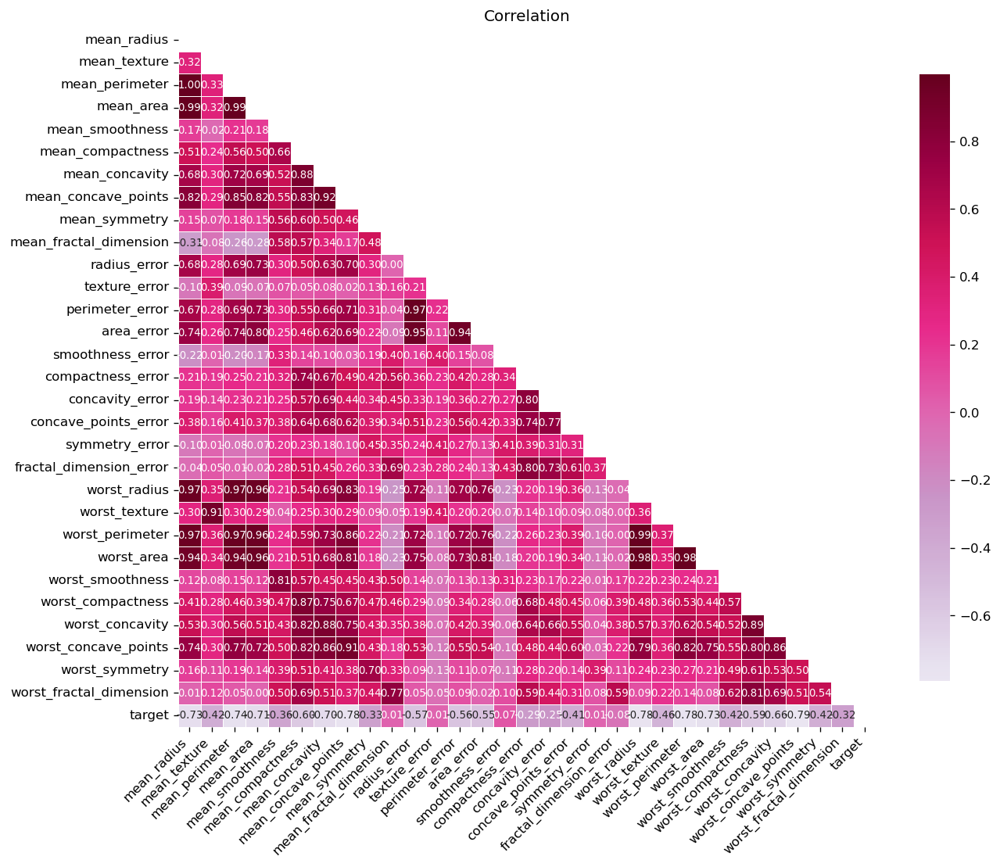

In [6]:
# Corelation of the data

# Set figure size and DPI
plt.figure(figsize=(12, 12), dpi=120)

# Compute correlation matrix
corr = df.corr()

# Create a mask to hide the upper triangle (including the diagonal)
mask = np.triu(np.ones_like(corr, dtype=bool))

# Customize the color palette
cmap = sns.color_palette("coolwarm", as_cmap=True)

# Plot the correlation heatmap
sns.heatmap(corr, annot=True, mask=mask, cmap='PuRd', center=0,
            square=True, linewidths=0.5, cbar_kws={"shrink": 0.7},
            fmt=".2f", annot_kws={"fontsize": 8})

# Rotate x-axis labels
plt.xticks(rotation=45, ha='right')

# Set title
plt.title('Correlation', fontsize=12)

# Display the plot
plt.show()

# `Univariate data analysis`


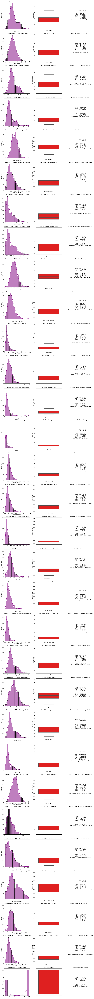

In [7]:
def analyze_univariate(data):
    """
    Perform univariate analysis on each column in the DataFrame.

    Parameters:
        data (DataFrame): The input DataFrame.

    Returns:
        None
    """
    num_cols = len(data.columns)
    fig, axes = plt.subplots(num_cols, 3, figsize=(15, num_cols*5))
    plt.subplots_adjust(hspace=0.5)

    # Iterate over each column in the DataFrame
    for i, column in enumerate(data.columns):
        # Perform univariate analysis for the column
        univariate_analysis(data, column, axes[i])

    plt.tight_layout()
    plt.show()


def univariate_analysis(data, column, axes):
    """
    Perform univariate analysis on a single column of the DataFrame.

    Parameters:
        data (DataFrame): The input DataFrame.
        column (str): The name of the column to analyze.
        axes (matplotlib.axes._subplots.AxesSubplot): The axes to plot the analysis.

    Returns:
        None
    """
    # Summary statistics
    stats = data[column].describe()

    # Histogram with KDE
    sns.histplot(data=data, x=column, kde=True,
                 color='purple', edgecolor='black', ax=axes[0])
    axes[0].set_xlabel(column)
    axes[0].set_ylabel("Frequency")
    axes[0].set_title("Histogram and KDE Plot of " + column)

    # Box plot
    sns.boxplot(data=data, y=column, color='red', ax=axes[1])
    axes[1].set_xlabel(column)
    axes[1].set_title("Box Plot of " + column)

    # Summary statistics text
    axes[2].text(0.5, 0.5, str(stats), fontsize=12, ha='center', va='center')
    axes[2].axis('off')
    axes[2].set_title("Summary Statistics of " + column)


analyze_univariate(df)

# `There are a good amount of outlairs present in my data set.`


In [8]:
list(df)

['mean_radius',
 'mean_texture',
 'mean_perimeter',
 'mean_area',
 'mean_smoothness',
 'mean_compactness',
 'mean_concavity',
 'mean_concave_points',
 'mean_symmetry',
 'mean_fractal_dimension',
 'radius_error',
 'texture_error',
 'perimeter_error',
 'area_error',
 'smoothness_error',
 'compactness_error',
 'concavity_error',
 'concave_points_error',
 'symmetry_error',
 'fractal_dimension_error',
 'worst_radius',
 'worst_texture',
 'worst_perimeter',
 'worst_area',
 'worst_smoothness',
 'worst_compactness',
 'worst_concavity',
 'worst_concave_points',
 'worst_symmetry',
 'worst_fractal_dimension',
 'target']

In [10]:
import cudf
import seaborn as sns
import matplotlib.pyplot as plt
import time

# Load the breast cancer dataset using cuDF
gdf = cudf.read_csv('data/breast_cancer_data.csv')

# Select a subset of columns for the pair plot
columns = [
    'mean_radius', 'mean_texture', 'mean_perimeter', 'mean_area',
    'mean_smoothness', 'mean_compactness', 'mean_concavity', 'mean_concave_points',
    'mean_symmetry', 'mean_fractal_dimension', 'radius_error', 'texture_error',
    'perimeter_error', 'area_error', 'smoothness_error', 'compactness_error',
    'concavity_error', 'concave_points_error', 'symmetry_error', 'fractal_dimension_error',
    'worst_radius', 'worst_texture', 'worst_perimeter', 'worst_area',
    'worst_smoothness', 'worst_compactness', 'worst_concavity', 'worst_concave_points',
    'worst_symmetry', 'worst_fractal_dimension', 'target'
]

# Convert the selected columns to a cuDF DataFrame
gdf_subset = gdf[columns]

# Convert the cuDF DataFrame to a pandas DataFrame
df_subset = gdf_subset.to_pandas()

# Measure the time taken to plot the pair plot
start_time = time.time()

# Plot the pair plot using seaborn
sns.pairplot(df_subset, hue='target')

# Calculate the time taken
end_time = time.time()
execution_time = end_time - start_time

# Show the plot
plt.show()

# Print the execution time
print("Execution time: %.2f seconds" % execution_time)


Execution time: 218.13 seconds
